### Import modules

In [2]:
%load_ext autoreload
%matplotlib inline

In [3]:
%autoreload 2

from IPython import display
from utils import Logger 

import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

import numpy as np
import matplotlib.pyplot as plt
import pickle

In [4]:
import trimesh
import trimesh.voxel.creation
import rtree

In [5]:
import matplotlib.tri as tri

In [6]:
import skimage
import skimage.measure

In [7]:
from scipy.ndimage import uniform_filter1d, convolve1d, convolve

In [8]:
import os

In [9]:
#this is for the interactive plot
# %matplotlib notebook

### Dataset

In [10]:
img_size = 120

In [11]:
data_transforms = transforms.Compose([
    transforms.Grayscale(num_output_channels=1),
    transforms.Resize(img_size),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])])

In [12]:
train_set0 = datasets.ImageFolder('./sections/all/a',data_transforms)
train_set1 = datasets.ImageFolder('./sections/all/b',data_transforms)
train_set2 = datasets.ImageFolder('./sections/all/c',data_transforms)
train_set3 = datasets.ImageFolder('./sections/all/d',data_transforms)
train_set4 = datasets.ImageFolder('./sections/all/e',data_transforms)
train_set5 = datasets.ImageFolder('./sections/all/f',data_transforms)
train_set6 = datasets.ImageFolder('./sections/all/g',data_transforms)
train_set7 = datasets.ImageFolder('./sections/all/h',data_transforms)
train_set8 = datasets.ImageFolder('./sections/all/i',data_transforms)
train_set9 = datasets.ImageFolder('./sections/all/j',data_transforms)
train_set10 = datasets.ImageFolder('./sections/all/k',data_transforms)

In [13]:
train_loader = torch.utils.data.DataLoader(train_set0, batch_size=3, shuffle=True)

In [14]:
num_batches=len(train_loader)

### Networks

In [15]:
class DiscriminatorNet(torch.nn.Module):
    
    #3 hidden-layer discriminative nn
    
    def __init__(self, img_size):
        super(DiscriminatorNet, self).__init__()
        n_features = img_size*img_size
        n_out=1
        
#         self.conv1 = nn.Sequential(
#             nn.Conv1d(1,n_features,2,1,padding=1 ))
        
        self.hidden0=nn.Sequential(
            nn.Linear(n_features,1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden1=nn.Sequential(
            nn.Linear(1024,512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden2=nn.Sequential(
            nn.Linear(512,256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.out=nn.Sequential(
            torch.nn.Linear(256,n_out),
            torch.nn.Sigmoid()
        )
        
    def forward(self, x):
#         x = self.conv1(x)
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
        


In [16]:
class GeneratorNet(torch.nn.Module):
    def __init__(self,n_features):
        super(GeneratorNet,self).__init__()
        self.n_features=n_features
        n_out=img_size*img_size
        
        self.hidden0=nn.Sequential(
            nn.Linear(self.n_features,256),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden1=nn.Sequential(
            nn.Linear(256,512),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden2=nn.Sequential(
            nn.Linear(512,1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.out=nn.Sequential(
            nn.Linear(1024,n_out),
            nn.Tanh()
        )
        
    
    def forward(self,x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
    


In [17]:
#Functions to convert from image to vector

def images_to_vectors(images):
    return images.view(images.size(0),img_size*img_size)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0),1,img_size,img_size)

In [18]:
def noise(size):
    #1-d vector of gaussian sampled random values
    
    n= Variable(torch.randn(size,100))
    #pass to the GPU
    if torch.cuda.is_available(): return n.cuda()
    return n

In [19]:
def real_data_target(size):
  
    data = Variable(torch.ones(size, 1))
    if torch.cuda.is_available(): return data.cuda()
    return data

def fake_data_target(size):
    
    data = Variable(torch.zeros(size, 1))
    if torch.cuda.is_available(): return data.cuda()
    return data

### Model

In [20]:
logger = Logger(model_name='sGAN', data_name='domes')

In [21]:
import time

In [22]:
class adversarialModel(object):
    def __init__(self, num_epochs=100, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=40, lat_vec =100,
                betas = (0.5,0.5),dataset = 'input_data',dataset_name = 'domesA',
                data_path='output/models/', transforms=None):
        #define parameters
        self.num_epochs=num_epochs
        self.samples = samples
        self.batch = batch
        self.g_lr = g_lr
        self.d_lr = d_lr
        self.size = size
        self.latent = lat_vec
        self.betas = betas
        self.dataset = dataset
        self.dataset_name = dataset_name
        self.name = 'sectionModel'
        self.saved_path = '/saved_models'
        
        #define networks
        self.generator = GeneratorNet(n_features=self.latent)
        self.discriminator = DiscriminatorNet(img_size = size)
        self.d_optimizer = optim.Adam(self.discriminator.parameters(), lr=self.d_lr, betas=betas)
        self.g_optimizer = optim.Adam(self.generator.parameters(), lr=self.d_lr, betas=betas)
        self.loss = nn.BCELoss()
        
        self.generator.cuda()
        self.discriminator.cuda()
        
        #data
        data_set = self.dataset
        self.data_loader = torch.utils.data.DataLoader(data_set, batch_size=self.batch, shuffle=True, num_workers=0)
        self.num_batches = len(self.data_loader)
        
    def train(self):
          
        start_time = time.time()
        for epoch in range(self.num_epochs):          
            
            for i,(real_batch,_) in enumerate(self.data_loader):
                
                real_data = Variable(images_to_vectors(real_batch))
                real_data = real_data.cuda()
                
                if(real_data.size()[0] != self.batch):
                    print('Batch size incompatible')
                    continue
               
               #train discriminator on real data
                self.d_optimizer.zero_grad()
                prediction_real = self.discriminator(real_data)
                d_real_loss = self.loss(prediction_real,real_data_target(prediction_real.size(0)))
                d_real_loss.backward()   
                
                #train on fake
                z = noise(real_batch.size(0))
                z = z.cuda()
                                
                fake_samples = self.generator(z)
                prediction_fake = self.discriminator(fake_samples )
                d_fake_loss = self.loss(prediction_fake, fake_data_target(self.batch))
                d_fake_loss.backward()
                
                self.d_optimizer.step()            
                           
                #regenerate samples and train generator
                
                z = noise(real_batch.size(0))
                z = z.cuda()
                fake_samples = self.generator(z)
                
                self.g_optimizer.zero_grad()               
               
                prediction_fake = self.discriminator(fake_samples)
                g_loss = self.loss(prediction_fake, real_data_target(prediction_fake.size(0)))
               
                g_loss.backward(retain_graph=True)               
                self.g_optimizer.step()
                
     
                
                if (epoch%50 == 0) and (i==0): 
                    print('Epoch : ', epoch)
                    print('Batch : ', i)
                    print('discriminator loss: ',(d_fake_loss+d_real_loss), '  generator loss: ', g_loss)
                    
                    #display.clear_output(True)
                    # Display Images
                    test_images = vectors_to_images(self.generator(test_noise)).data.cpu()
                    logger.log_images(test_images, num_test_samples, epoch, i, self.num_batches);
                
              
    def save_model(self):
        path = os.path.join(self.saved_path, self.dataset_name,self.name)
        print(path)
        if not os.path.exists(path):
            os.makedirs(path)
            
        torch.save(self.generator.state_dict(), os.path.join(path,self.name+ 'GeneratorNet.pkl'))
        torch.save(self.discriminator.state_dict(), os.path.join(path,self.name+ 'DiscriminatorNet.pkl'))
       
 #         with open(os.path.join(path, self.name + '_history.pkl'), 'wb') as f:
 #             pickle.dump(f)
        
    def load_model(self,model_name,dataset_name):
        path = os.path.join(self.saved_path, dataset_name,self.name)
        self.discriminator.load_state_dict(torch.load(os.path.join(path, model_name+ 'DiscriminatorNet.pkl')))
        self.generator.load_state_dict(torch.load(os.path.join(path, model_name+ 'GeneratorNet.pkl')))
       
        
        
            
                
        

### Training

In [28]:
model0 = adversarialModel(num_epochs=3000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set0,data_path='output/models/', transforms=None)

In [29]:
num_test_samples=5
test_noise=noise(num_test_samples)

Epoch :  0
Batch :  0
discriminator loss:  tensor(1.3666, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7097, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


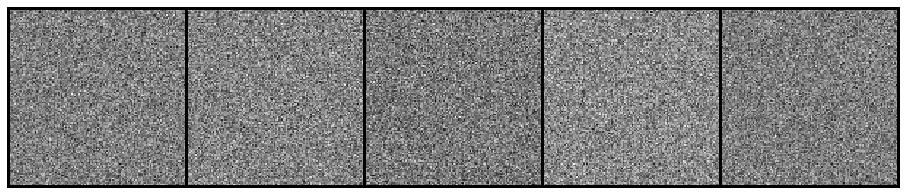

Epoch :  50
Batch :  0
discriminator loss:  tensor(0.7361, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7117, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


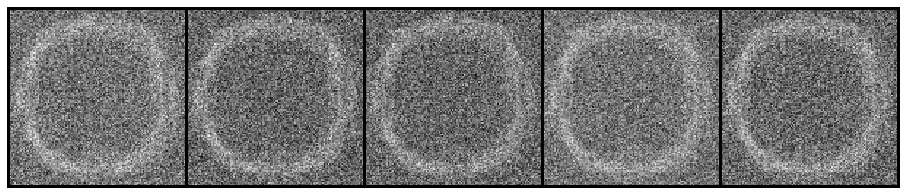

Epoch :  100
Batch :  0
discriminator loss:  tensor(0.8954, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0553, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


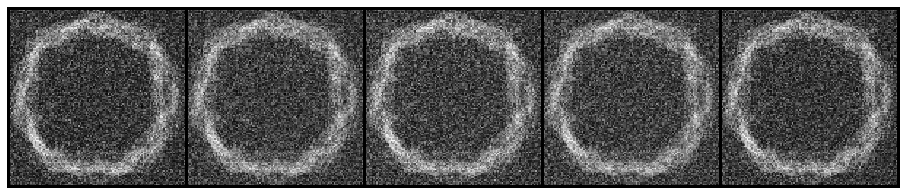

Epoch :  150
Batch :  0
discriminator loss:  tensor(0.8190, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.8490, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


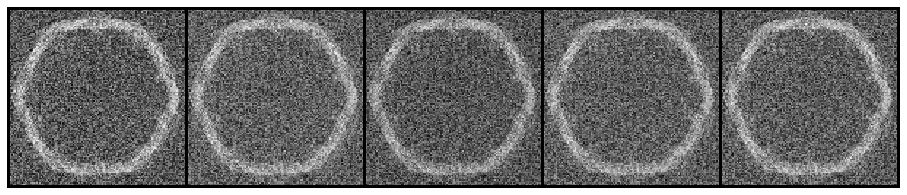

Epoch :  200
Batch :  0
discriminator loss:  tensor(0.8931, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9930, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


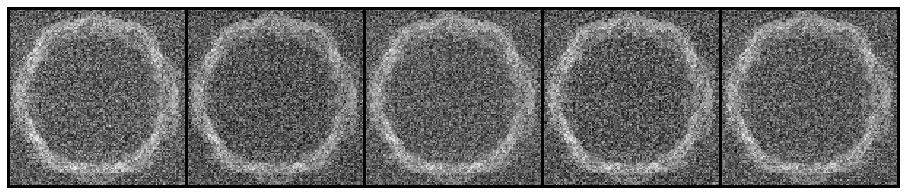

Epoch :  250
Batch :  0
discriminator loss:  tensor(0.9779, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.8813, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


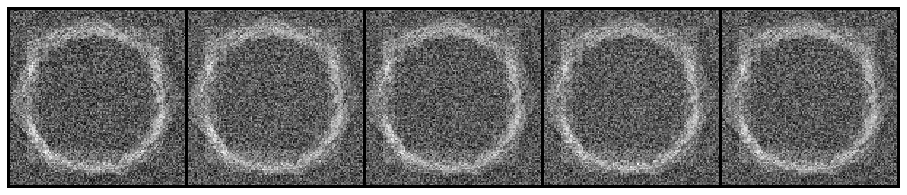

Epoch :  300
Batch :  0
discriminator loss:  tensor(0.2804, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.4208, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


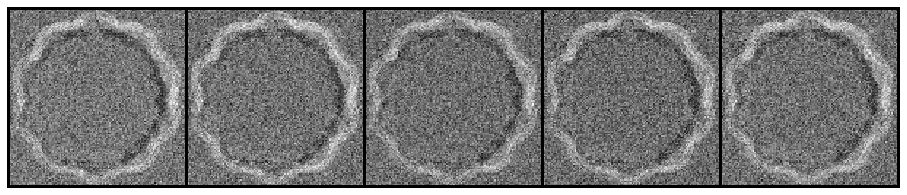

Epoch :  350
Batch :  0
discriminator loss:  tensor(0.3638, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0328, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


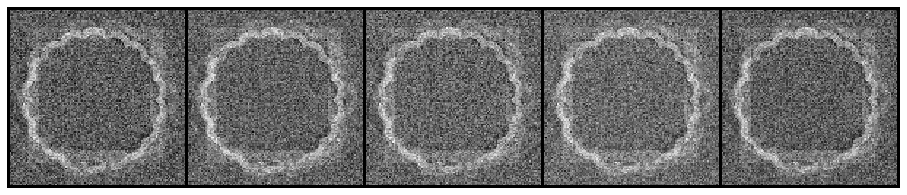

Epoch :  400
Batch :  0
discriminator loss:  tensor(0.3726, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.1021, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


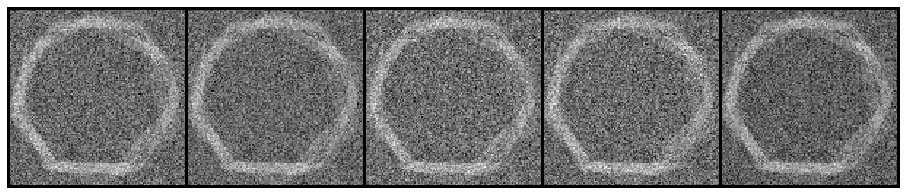

Epoch :  450
Batch :  0
discriminator loss:  tensor(0.5326, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0548, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


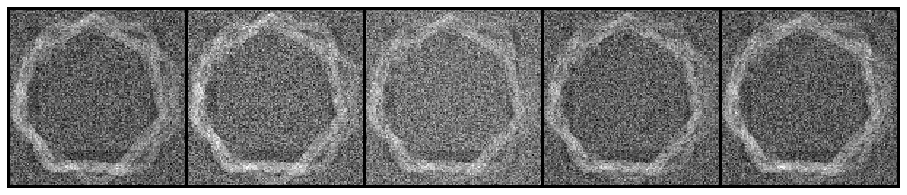

Epoch :  500
Batch :  0
discriminator loss:  tensor(0.6318, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2432, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


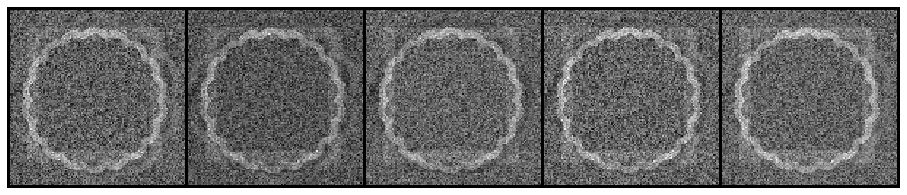

Epoch :  550
Batch :  0
discriminator loss:  tensor(0.5154, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9650, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


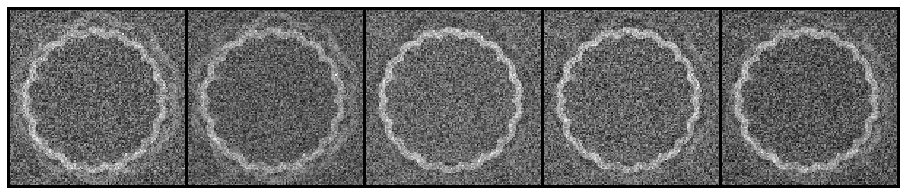

Epoch :  600
Batch :  0
discriminator loss:  tensor(0.2154, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.5573, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


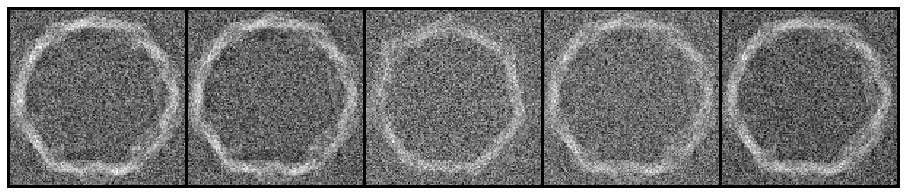

Epoch :  650
Batch :  0
discriminator loss:  tensor(0.4859, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.1938, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


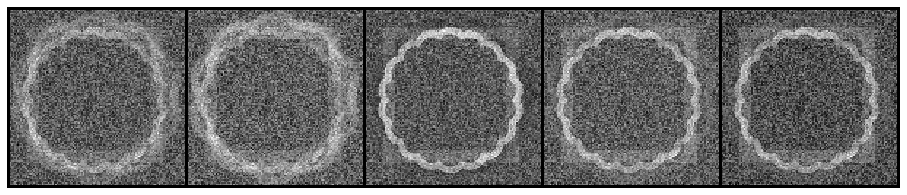

Epoch :  700
Batch :  0
discriminator loss:  tensor(0.1771, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5570, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


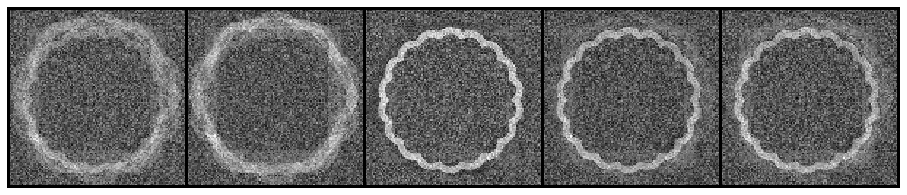

Epoch :  750
Batch :  0
discriminator loss:  tensor(0.3570, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7761, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


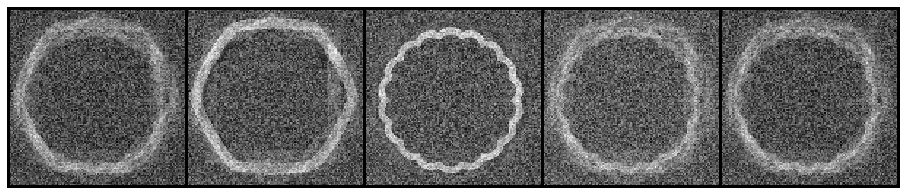

Epoch :  800
Batch :  0
discriminator loss:  tensor(1.3161, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7065, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


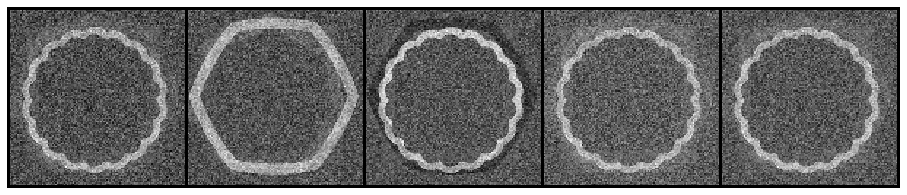

Epoch :  850
Batch :  0
discriminator loss:  tensor(0.3265, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.0043, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


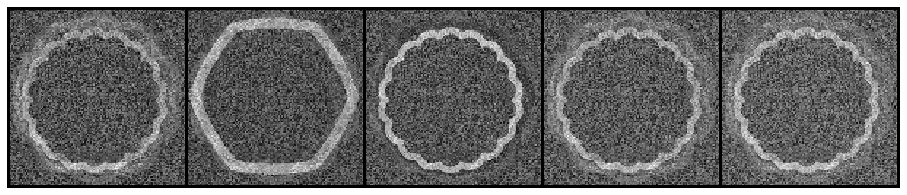

Epoch :  900
Batch :  0
discriminator loss:  tensor(1.8305, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.9278, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


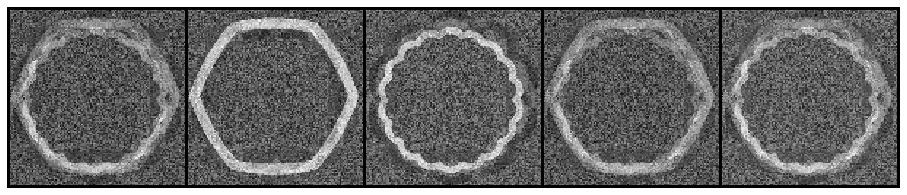

Epoch :  950
Batch :  0
discriminator loss:  tensor(1.4992, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7004, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


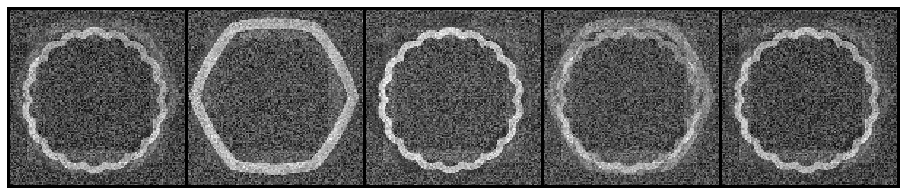

Epoch :  1000
Batch :  0
discriminator loss:  tensor(0.2751, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.6573, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


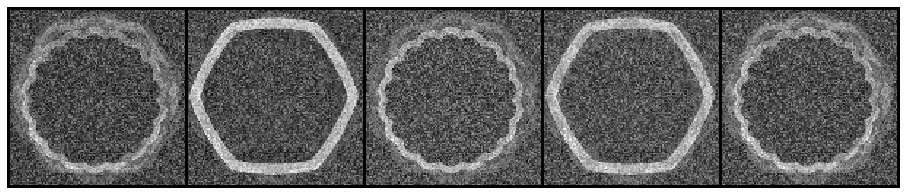

Epoch :  1050
Batch :  0
discriminator loss:  tensor(1.2456, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6798, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


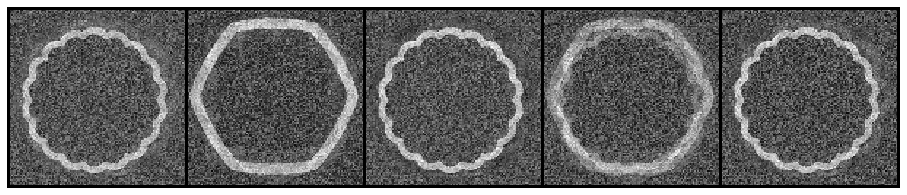

Epoch :  1100
Batch :  0
discriminator loss:  tensor(0.2946, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.1127, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


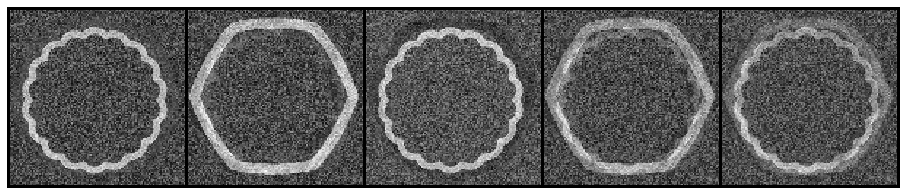

Epoch :  1150
Batch :  0
discriminator loss:  tensor(0.1234, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.4491, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


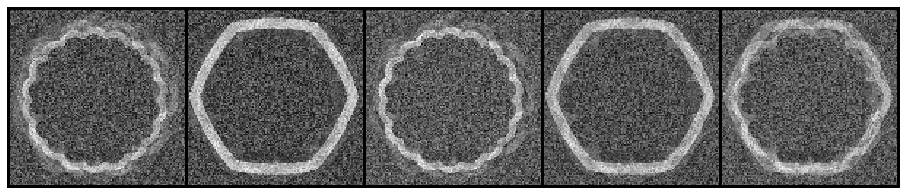

Epoch :  1200
Batch :  0
discriminator loss:  tensor(0.2970, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2110, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


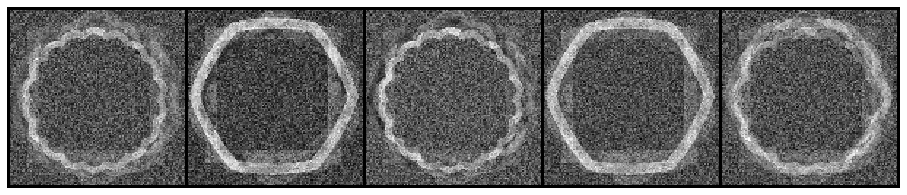

Epoch :  1250
Batch :  0
discriminator loss:  tensor(0.8018, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0032, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


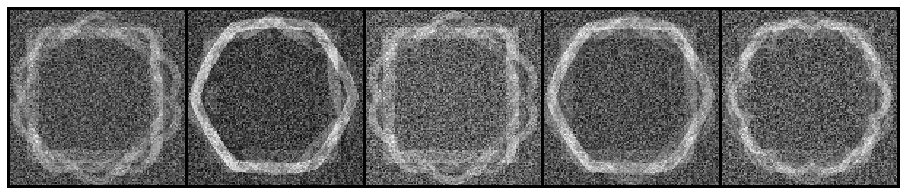

Epoch :  1300
Batch :  0
discriminator loss:  tensor(0.8365, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0066, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


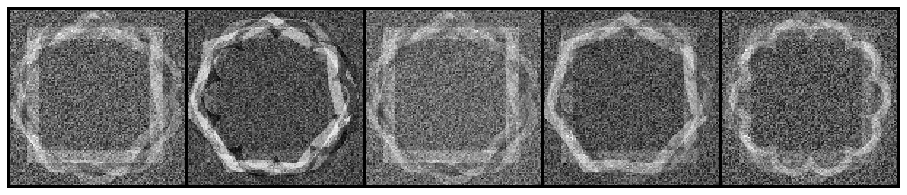

Epoch :  1350
Batch :  0
discriminator loss:  tensor(0.4792, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.1500, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


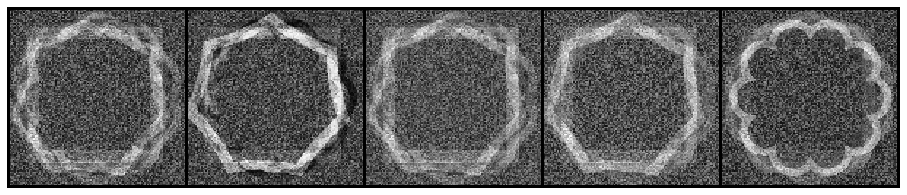

Epoch :  1400
Batch :  0
discriminator loss:  tensor(0.2814, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.9280, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


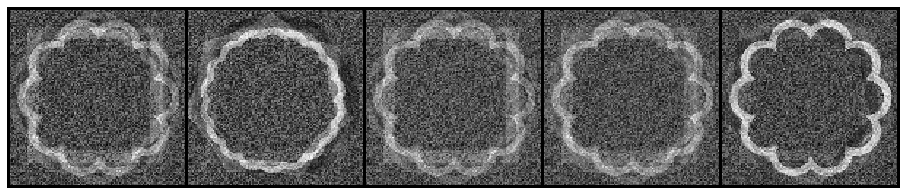

Epoch :  1450
Batch :  0
discriminator loss:  tensor(0.1686, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.2158, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


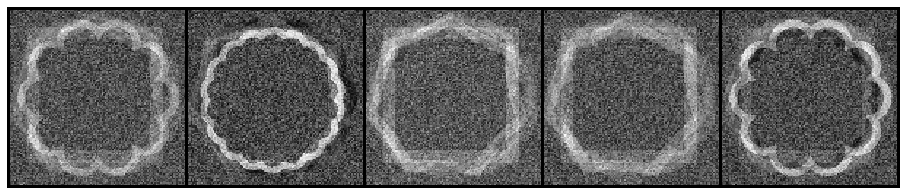

Epoch :  1500
Batch :  0
discriminator loss:  tensor(0.5314, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8732, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


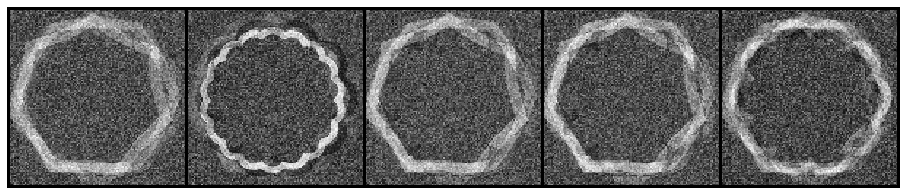

Epoch :  1550
Batch :  0
discriminator loss:  tensor(1.0928, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8890, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


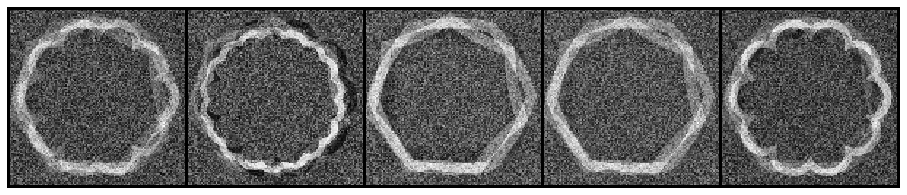

Epoch :  1600
Batch :  0
discriminator loss:  tensor(0.5925, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8093, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


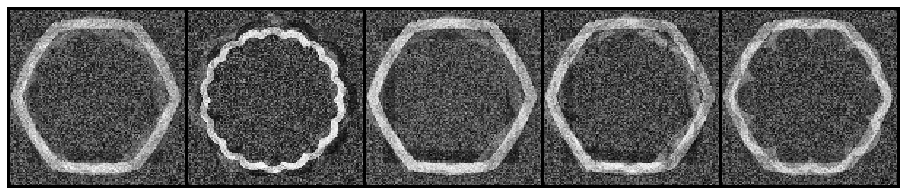

Epoch :  1650
Batch :  0
discriminator loss:  tensor(1.5714, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8342, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


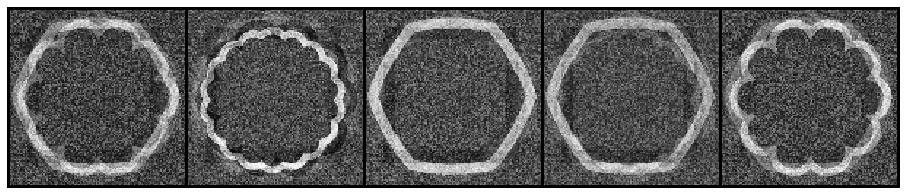

Epoch :  1700
Batch :  0
discriminator loss:  tensor(1.4264, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2591, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


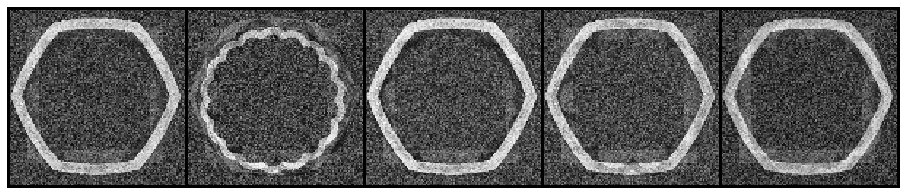

Epoch :  1750
Batch :  0
discriminator loss:  tensor(0.3699, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5618, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


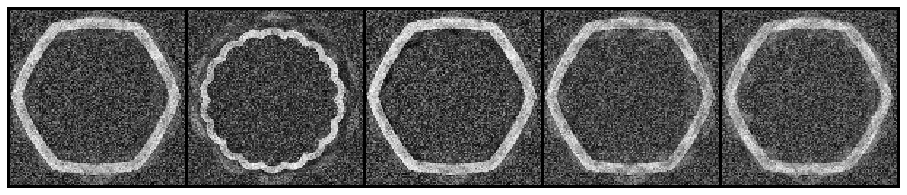

Epoch :  1800
Batch :  0
discriminator loss:  tensor(1.8459, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.9997, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


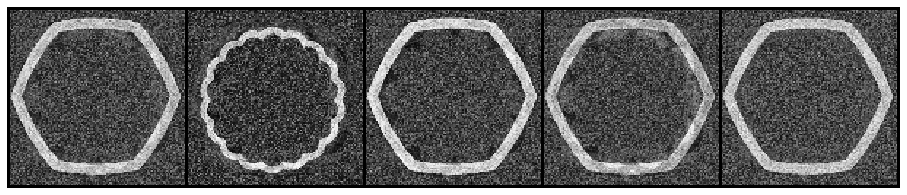

Epoch :  1850
Batch :  0
discriminator loss:  tensor(0.3386, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.6306, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


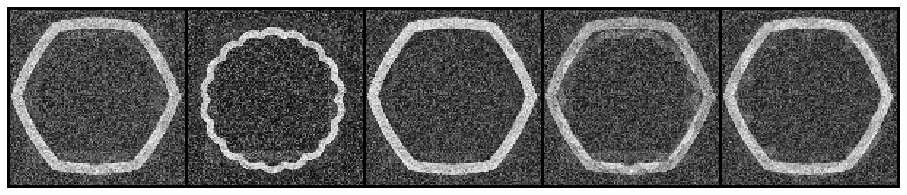

Epoch :  1900
Batch :  0
discriminator loss:  tensor(1.4173, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8519, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


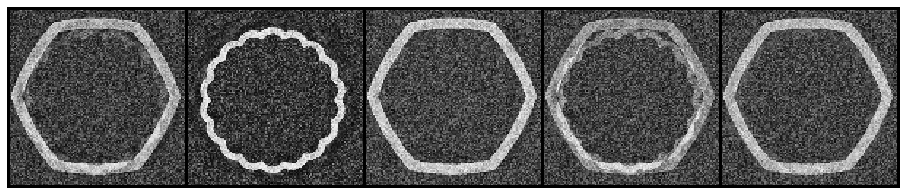

Epoch :  1950
Batch :  0
discriminator loss:  tensor(0.3764, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9251, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


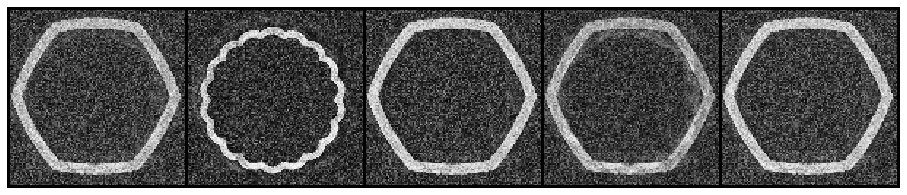

Epoch :  2000
Batch :  0
discriminator loss:  tensor(1.1706, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.3669, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


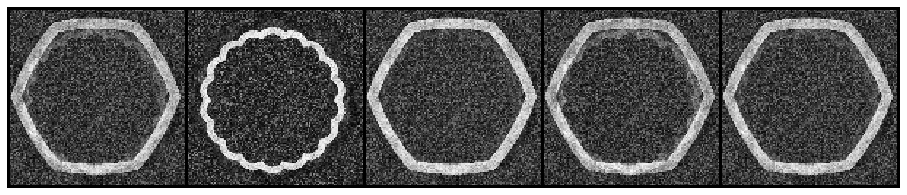

Epoch :  2050
Batch :  0
discriminator loss:  tensor(0.5985, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.4805, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


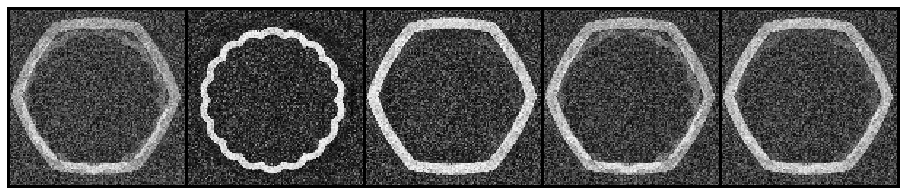

Epoch :  2100
Batch :  0
discriminator loss:  tensor(1.2390, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.3482, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


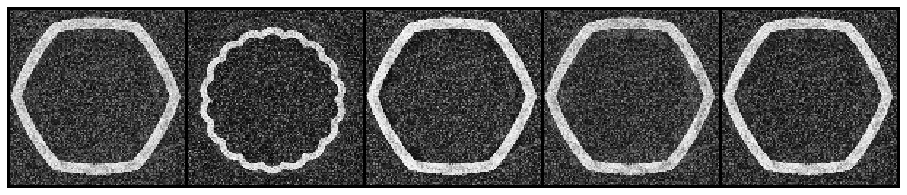

Epoch :  2150
Batch :  0
discriminator loss:  tensor(0.4380, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2070, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


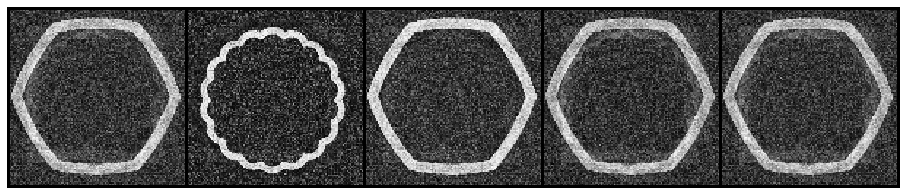

Epoch :  2200
Batch :  0
discriminator loss:  tensor(0.3985, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7311, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


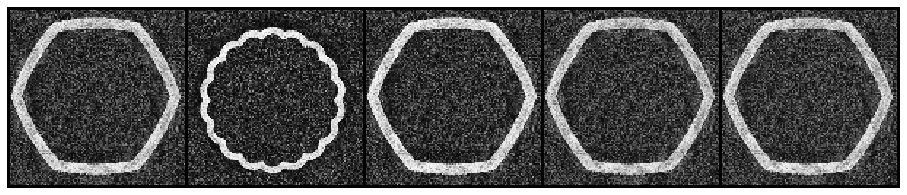

Epoch :  2250
Batch :  0
discriminator loss:  tensor(0.9834, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7513, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


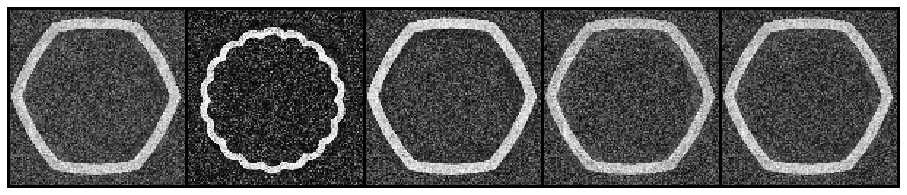

Epoch :  2300
Batch :  0
discriminator loss:  tensor(0.5722, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.8385, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


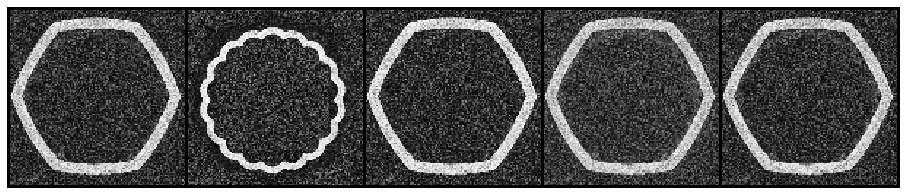

Epoch :  2350
Batch :  0
discriminator loss:  tensor(0.0928, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5117, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


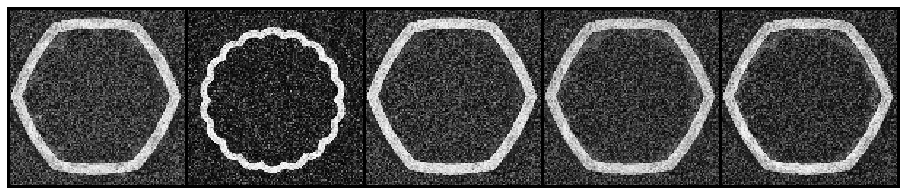

Epoch :  2400
Batch :  0
discriminator loss:  tensor(0.8120, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6652, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


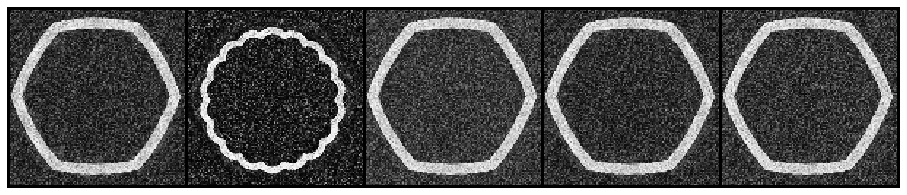

Epoch :  2450
Batch :  0
discriminator loss:  tensor(0.2864, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6166, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


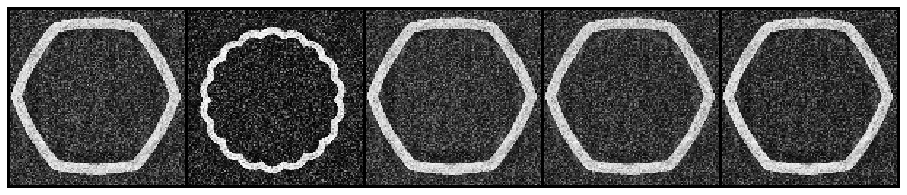

Epoch :  2500
Batch :  0
discriminator loss:  tensor(0.3079, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.3496, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


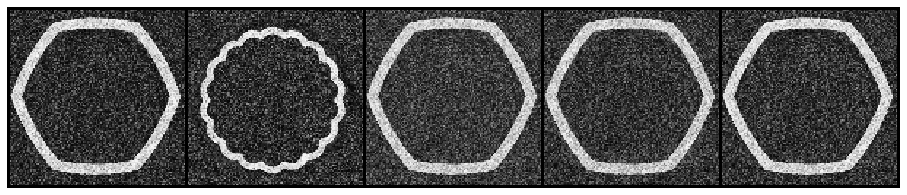

Epoch :  2550
Batch :  0
discriminator loss:  tensor(1.3488, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7084, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


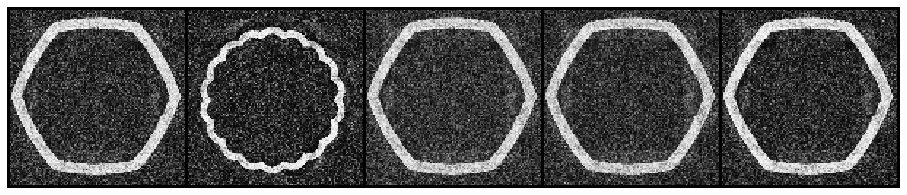

Epoch :  2600
Batch :  0
discriminator loss:  tensor(1.0994, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6066, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


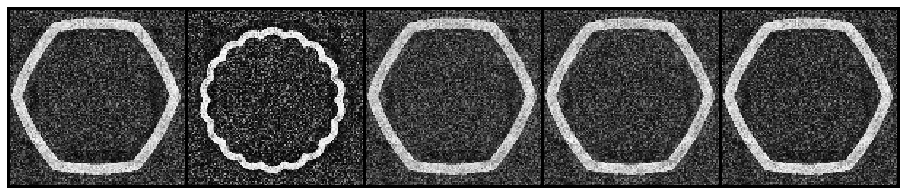

Epoch :  2650
Batch :  0
discriminator loss:  tensor(0.9060, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.4488, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


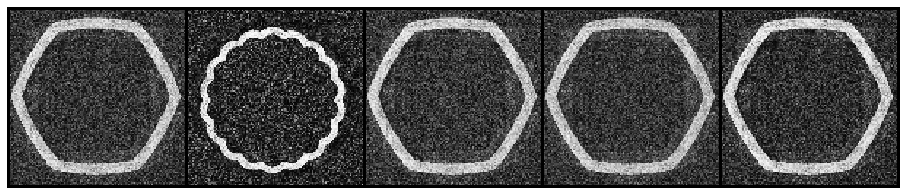

Epoch :  2700
Batch :  0
discriminator loss:  tensor(0.5307, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


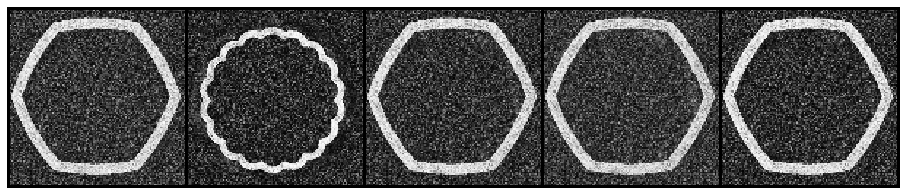

Epoch :  2750
Batch :  0
discriminator loss:  tensor(1.4875, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.9681, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


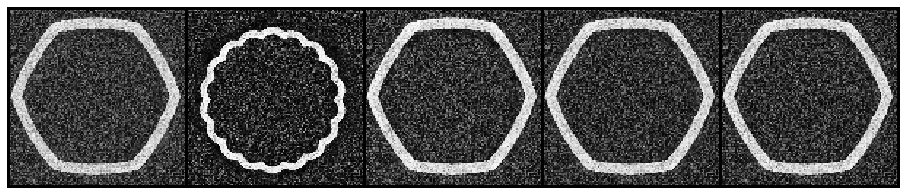

Epoch :  2800
Batch :  0
discriminator loss:  tensor(0.6712, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9872, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


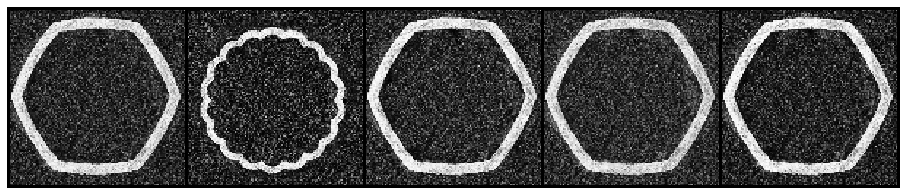

Epoch :  2850
Batch :  0
discriminator loss:  tensor(1.0191, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.8690, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


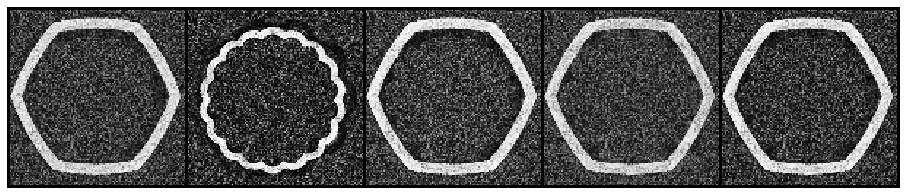

Epoch :  2900
Batch :  0
discriminator loss:  tensor(1.3758, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7327, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


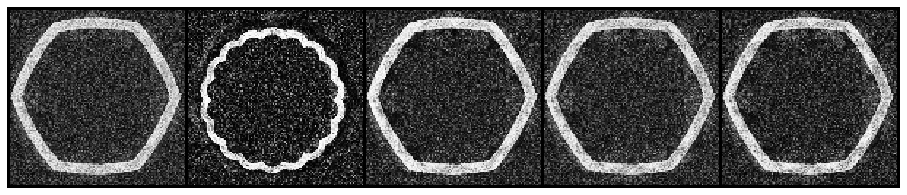

Epoch :  2950
Batch :  0
discriminator loss:  tensor(0.2184, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6133, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


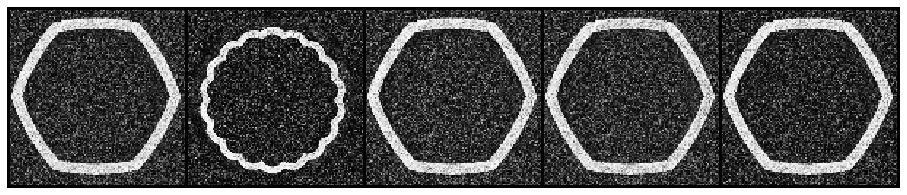

In [30]:
model0.train()

In [31]:
model0.save_model()

/saved_models\domesA\sectionModel


In [297]:
model1 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set1,dataset_name = 'domes1', data_path='output/models/', transforms=None)

Epoch :  0
Batch :  0
discriminator loss:  tensor(1.3666, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.6715, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


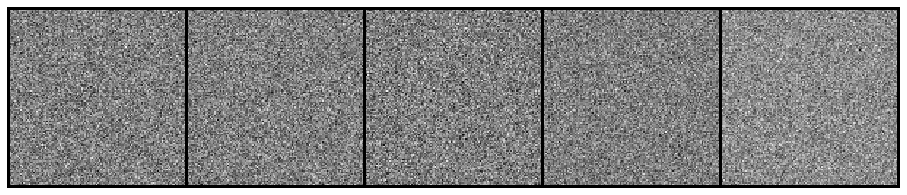

Epoch :  50
Batch :  0
discriminator loss:  tensor(0.6857, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7838, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


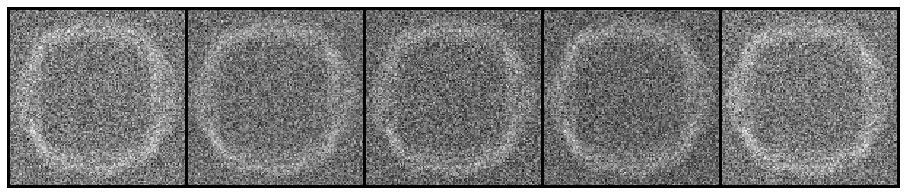

Epoch :  100
Batch :  0
discriminator loss:  tensor(0.6879, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.4547, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


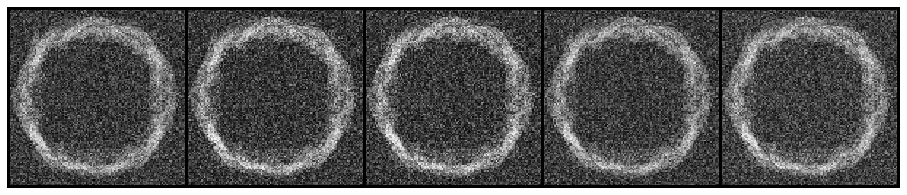

Epoch :  150
Batch :  0
discriminator loss:  tensor(1.0877, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7818, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


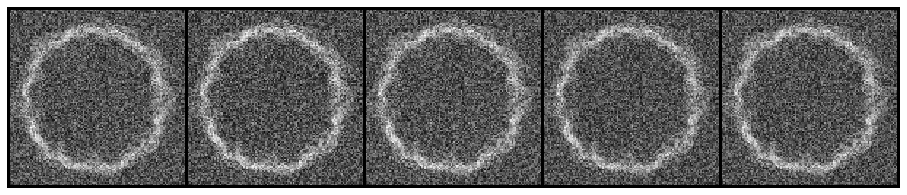

Epoch :  200
Batch :  0
discriminator loss:  tensor(0.9407, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7654, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


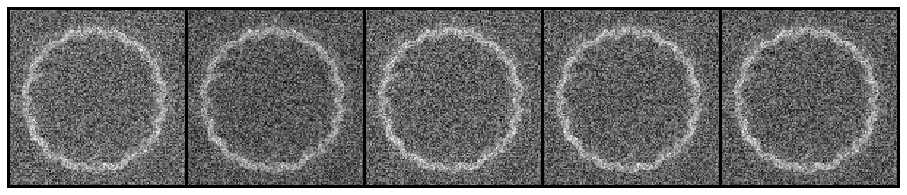

Epoch :  250
Batch :  0
discriminator loss:  tensor(0.6245, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9691, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


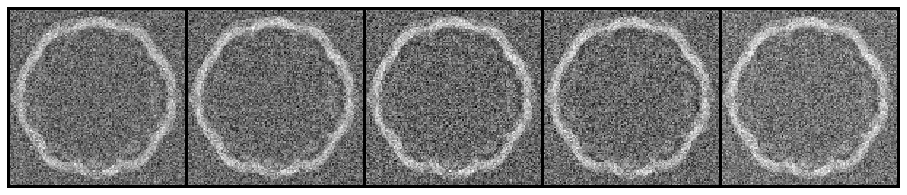

Epoch :  300
Batch :  0
discriminator loss:  tensor(0.6615, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7308, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


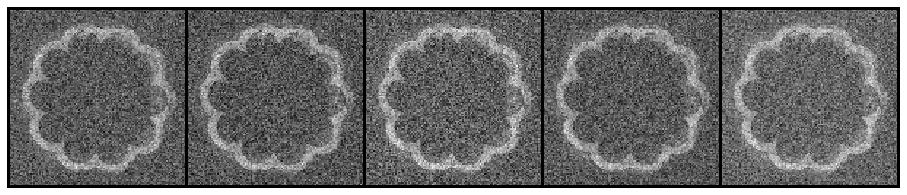

Epoch :  350
Batch :  0
discriminator loss:  tensor(0.3896, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.7327, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


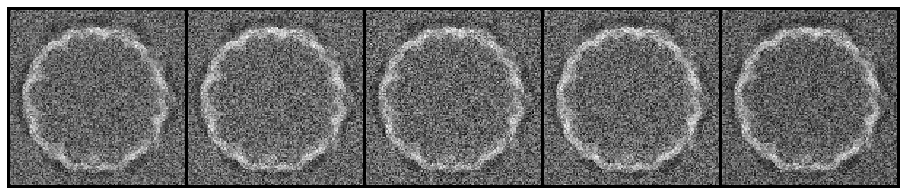

Epoch :  400
Batch :  0
discriminator loss:  tensor(0.7407, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.6867, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


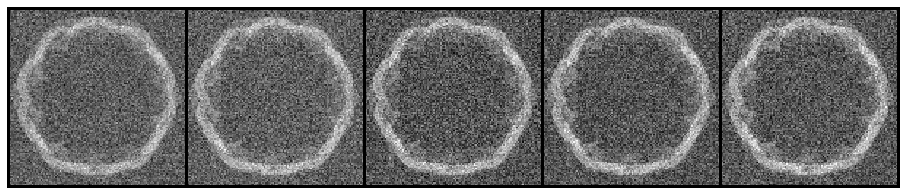

Epoch :  450
Batch :  0
discriminator loss:  tensor(1.0993, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2987, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


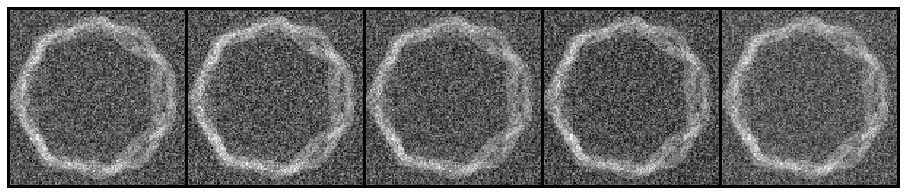

Epoch :  500
Batch :  0
discriminator loss:  tensor(0.9974, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.3700, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


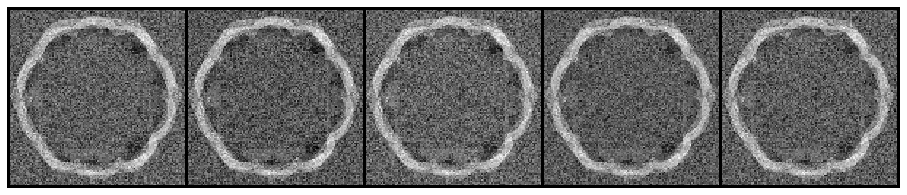

Epoch :  550
Batch :  0
discriminator loss:  tensor(0.9910, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.6609, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


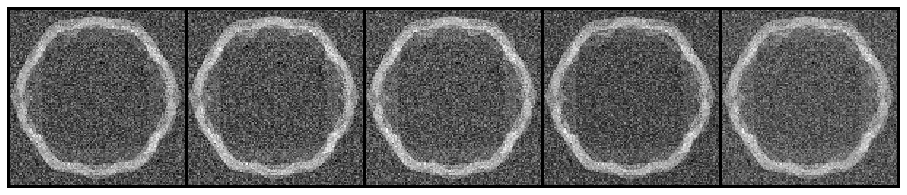

Epoch :  600
Batch :  0
discriminator loss:  tensor(0.5070, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7751, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


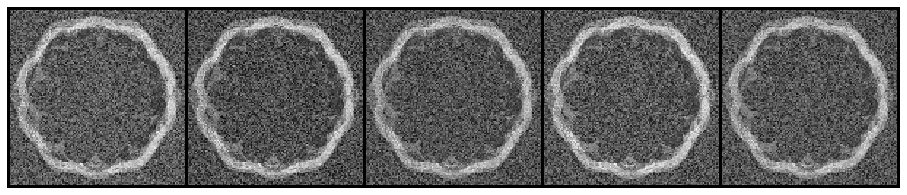

Epoch :  650
Batch :  0
discriminator loss:  tensor(0.8862, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.7692, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


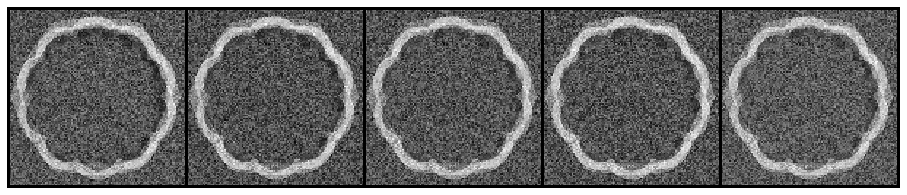

Epoch :  700
Batch :  0
discriminator loss:  tensor(0.4756, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5740, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


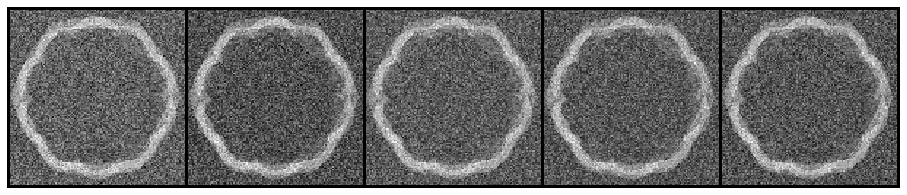

Epoch :  750
Batch :  0
discriminator loss:  tensor(1.1988, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.4958, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


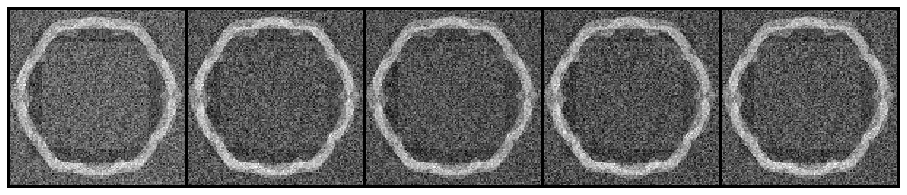

Epoch :  800
Batch :  0
discriminator loss:  tensor(0.5116, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.9770, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


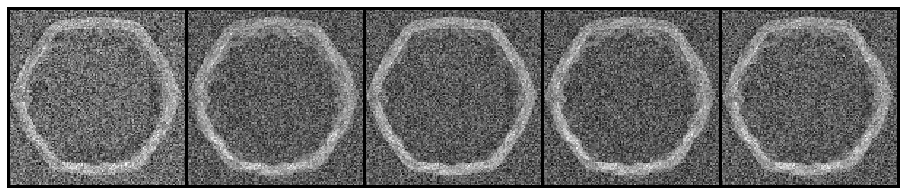

Epoch :  850
Batch :  0
discriminator loss:  tensor(0.5721, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0971, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


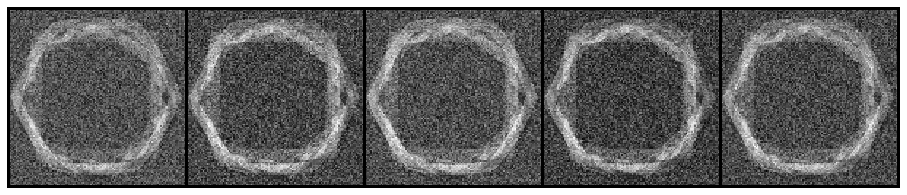

Epoch :  900
Batch :  0
discriminator loss:  tensor(0.3649, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.2101, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


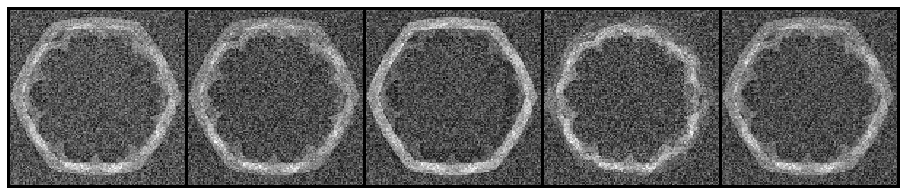

Epoch :  950
Batch :  0
discriminator loss:  tensor(0.6663, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.1039, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


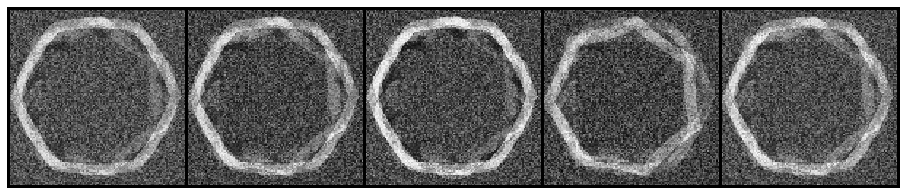

Epoch :  1000
Batch :  0
discriminator loss:  tensor(1.7946, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5103, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


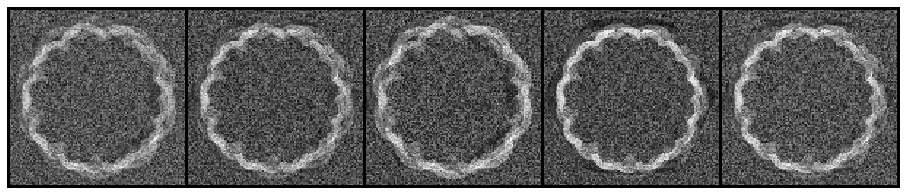

Epoch :  1050
Batch :  0
discriminator loss:  tensor(1.2261, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.3063, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


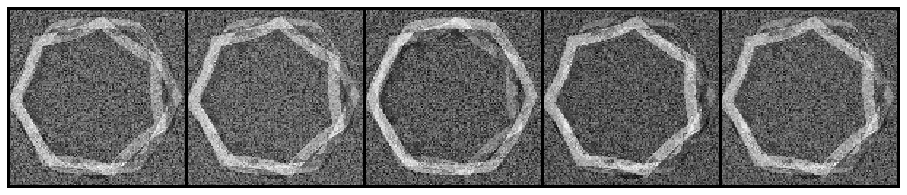

Epoch :  1100
Batch :  0
discriminator loss:  tensor(1.5159, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.1221, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


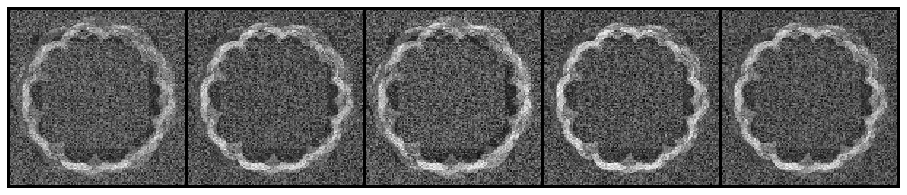

Epoch :  1150
Batch :  0
discriminator loss:  tensor(0.2927, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5237, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


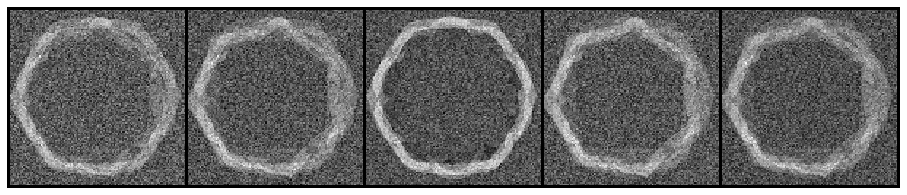

Epoch :  1200
Batch :  0
discriminator loss:  tensor(0.9671, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0807, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


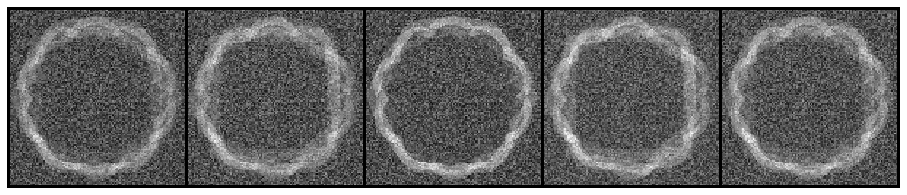

Epoch :  1250
Batch :  0
discriminator loss:  tensor(0.2135, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.3373, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


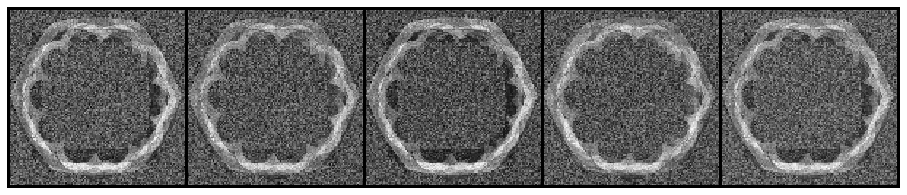

Epoch :  1300
Batch :  0
discriminator loss:  tensor(1.5430, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.2927, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


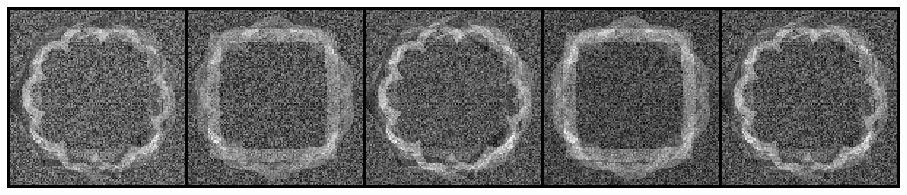

Epoch :  1350
Batch :  0
discriminator loss:  tensor(0.2664, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.5909, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


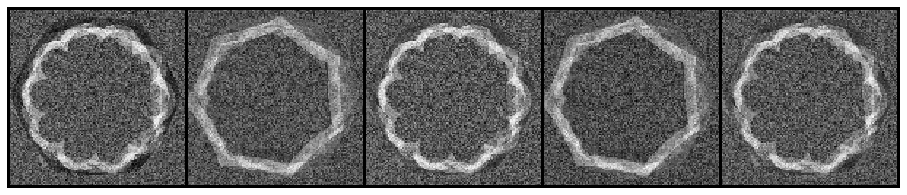

Epoch :  1400
Batch :  0
discriminator loss:  tensor(0.5933, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.5775, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


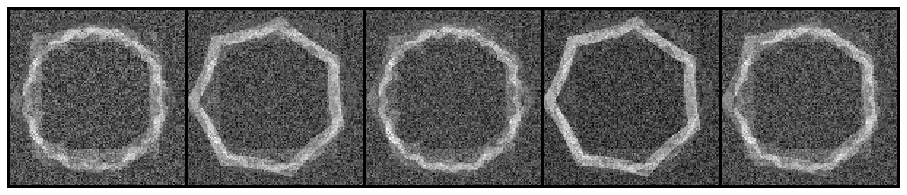

Epoch :  1450
Batch :  0
discriminator loss:  tensor(0.1142, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.9806, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


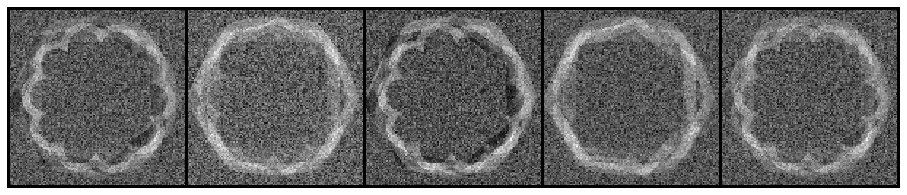

Epoch :  1500
Batch :  0
discriminator loss:  tensor(0.7773, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.9832, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


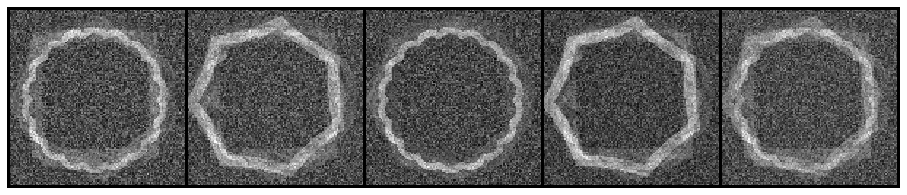

Epoch :  1550
Batch :  0
discriminator loss:  tensor(0.2673, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.7691, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


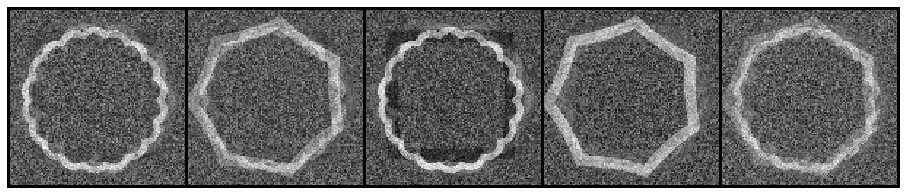

Epoch :  1600
Batch :  0
discriminator loss:  tensor(0.2421, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.8728, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


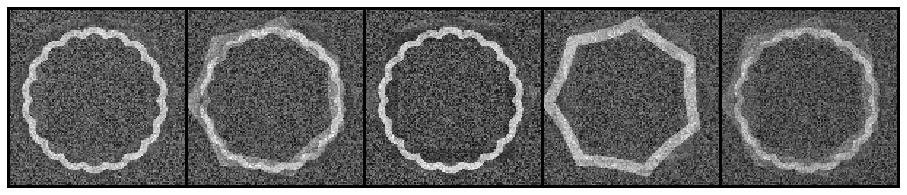

Epoch :  1650
Batch :  0
discriminator loss:  tensor(0.3514, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.2410, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


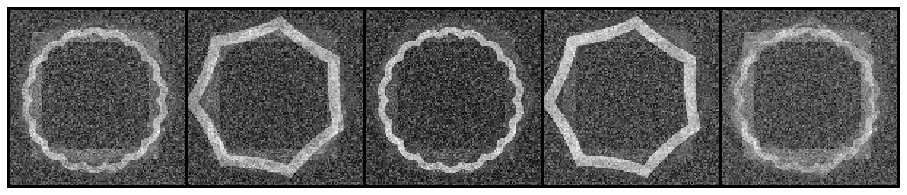

Epoch :  1700
Batch :  0
discriminator loss:  tensor(0.4846, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.9630, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


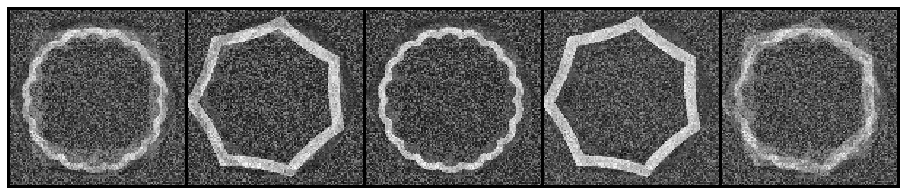

Epoch :  1750
Batch :  0
discriminator loss:  tensor(0.3230, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.6936, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


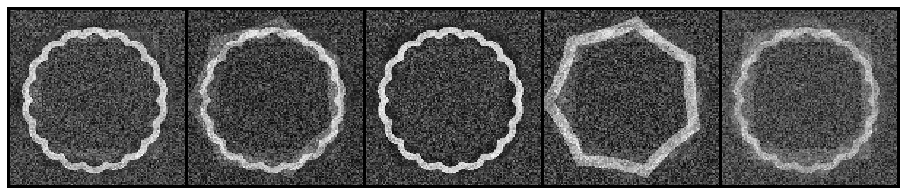

Epoch :  1800
Batch :  0
discriminator loss:  tensor(0.3029, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(1.0460, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


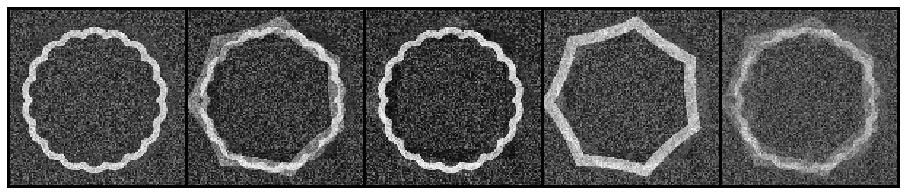

Epoch :  1850
Batch :  0
discriminator loss:  tensor(2.6002, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.5925, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


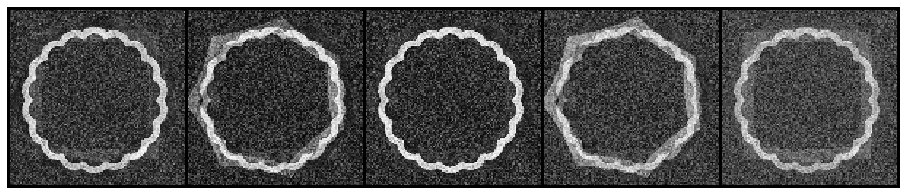

Epoch :  1900
Batch :  0
discriminator loss:  tensor(0.7849, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(0.6385, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


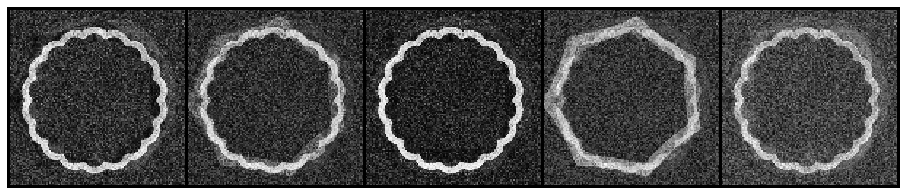

Epoch :  1950
Batch :  0
discriminator loss:  tensor(0.4730, device='cuda:0', grad_fn=<AddBackward0>)   generator loss:  tensor(2.1455, device='cuda:0', grad_fn=<BinaryCrossEntropyBackward>)


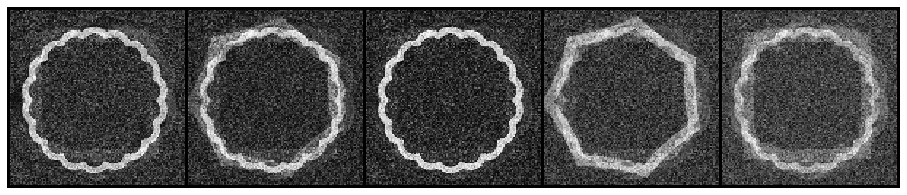

In [298]:
model1.train()

In [299]:
model1.save_model()

/saved_models\domes1\sectionModel


In [303]:
torch.cuda.empty_cache()

In [1]:
model2 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set2,dataset_name = 'domes2', data_path='output/models/', transforms=None)
model2.train()
model2.save_model()

NameError: name 'adversarialModel' is not defined

In [ ]:
model3 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set3,dataset_name = 'domes3', data_path='output/models/', transforms=None)
model3.train()
model3.save_model()

In [ ]:
model4 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set4,dataset_name = 'domes4', data_path='output/models/', transforms=None)
model4.train()
model4.save_model()

In [ ]:
model5 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set5,dataset_name = 'domes5', data_path='output/models/', transforms=None)
model5.train()
model5.save_model()

In [ ]:
model6 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set6,dataset_name = 'domes6', data_path='output/models/', transforms=None)
model6.train()
model6.save_model()

In [ ]:
model7 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set7,dataset_name = 'domes7', data_path='output/models/', transforms=None)
model7.train()
model7.save_model()

In [ ]:
model8 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set8,dataset_name = 'domes8', data_path='output/models/', transforms=None)
model8.train()
model8.save_model()

In [ ]:
model9 = adversarialModel(num_epochs=2000, samples=5, batch=3,
                g_lr=0.0002, d_lr=0.0001, size=120, lat_vec =100,
                betas = (0.5,0.5),dataset = train_set9,dataset_name = 'domes9', data_path='output/models/', transforms=None)
model9.train()
model9.save_model()

In [26]:
model0.load_model('sectionModel', 'domes0')

RuntimeError: Error(s) in loading state_dict for DiscriminatorNet:
	size mismatch for hidden0.0.weight: copying a param with shape torch.Size([1024, 3600]) from checkpoint, the shape in current model is torch.Size([1024, 14400]).

In [ ]:
m = model0

### Show samples

I store the models trained with each dataset, and call them to create one layer each

In [32]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.gridspec as gridspec

import scipy

In [33]:
models = [model0]#,model1,model2,model3,model4,model5,model6,model7,model8,model9]

In [36]:
layers = []
for i in range(10):
    sample_noise = noise(2).cuda()
    sample_section = models[i].generator(sample_noise).cpu().data.numpy()
    k = np.ones([3,3])
    z1 = convolve(sample_section[0].reshape(img_size,img_size),k)
    z2 = convolve(sample_section[1].reshape(img_size,img_size),k)
    image1 = np.squeeze(z1)
    image2 = np.squeeze(z2)
    positive1 = image1.__ge__(0.6)
    positive2 = image2.__ge__(0.6)
    layers.append(positive1.reshape(img_size,img_size,1))  
    layers.append(positive2.reshape(img_size,img_size,1))
  
    

In [37]:
v = np.concatenate(layers,axis=2)
v.shape

(120, 120, 2)

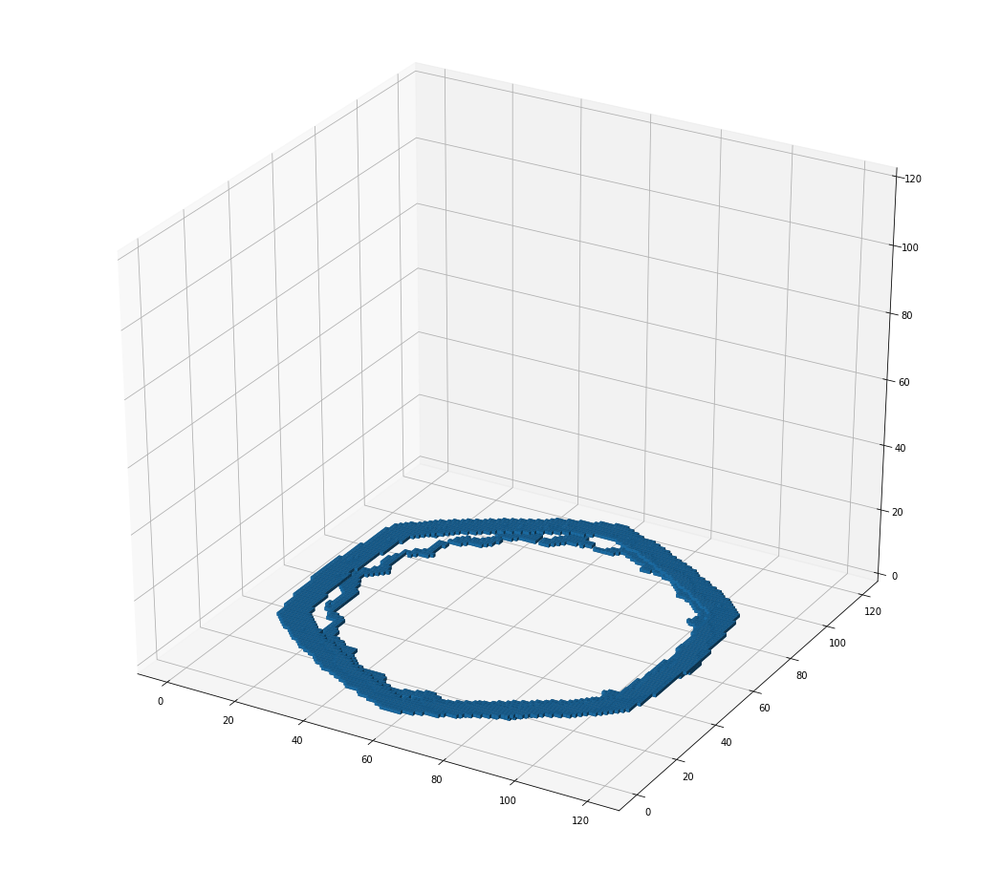

<Figure size 432x288 with 0 Axes>

In [38]:
voxels = np.zeros((img_size,img_size,img_size))
voxels[:np.size(v,0),:np.size(v,1),:np.size(v,2)] = v
#voxels[:np.size(source1,0),:np.size(source1,1),:np.size(source1,2)] = source1

fig = plt.figure()
fig.set_size_inches(18.5, 16.5)
ax = fig.gca(projection='3d')
ax.voxels(voxels)#, edgecolor='cyan')
plt.show()
plt.savefig('3dPlot.png')

##### Not needed  |__

Filter experiments

In [137]:
import scipy.ndimage as ndimage

In [153]:
from scipy.ndimage import uniform_filter1d, convolve1d, convolve

In [154]:
sample_noise = noise(1).cuda()
sample_section = model0.generator(sample_noise).cpu().data.numpy()

print(sample_section.shape)


(1, 3600)


In [178]:
klen = 5
kernel = np.ones(klen)
k = np.ones([10,10])
z1 = convolve(sample_section.reshape(60,60),k)

(3600,)


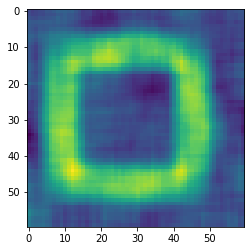

In [179]:

image = np.squeeze(sample_section,0)
positive = image.__ge__(0.1)
print(image.shape)
plt.imshow(z1)

plt.show()


In [ ]:
%matplotlib notebook
#calling it a second time may prevent some graphics errors
%matplotlib notebook 

voxels = np.zeros((60,60,60))
source = positive[0].reshape(60,60,1)
source1 = positive[1].reshape(60,60,1)
source2 = positive[2].reshape(60,60,1)
source3 = positive[3].reshape(60,60,1)
source4 = positive[4].reshape(60,60,1)
source5 = positive[5].reshape(60,60,1)
source6 = positive[6].reshape(60,60,1)
source7 = positive[7].reshape(60,60,1)
source8 = positive[8].reshape(60,60,1)
source9 = positive[9].reshape(60,60,1)
v = np.concatenate((source,source,source1,source1,source2,source2,source3,source3,source4,source4,
                   source5,source5,source6,source6,source7,source7,source8,source8,source9,source9),axis=2)
voxels[:np.size(v,0),:np.size(v,1),:np.size(v,2)] = v
#voxels[:np.size(source1,0),:np.size(source1,1),:np.size(source1,2)] = source1

fig = plt.figure()
fig.set_size_inches(18.5, 16.5)
ax = fig.gca(projection='3d')
ax.voxels(voxels)#, edgecolor='cyan')
plt.show()
plt.savefig('3dPlot.png')

##### Not needed |||||

### Create meshes

In [39]:
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

In [40]:
verts, faces, normals, values = skimage.measure.marching_cubes(v,0)

fig = plt.figure(figsize=(10,10))
#ax = fig.add_subplot(111, projection='3d')

# Fancy indexing: `verts[faces]` to generate a collection of triangles
mesh = Poly3DCollection(verts[faces])

# mesh.set_edgecolor('k')
# ax = fig.gca(projection='3d')
# ax.add_collection3d(mesh)

# ax.set_xlabel("x-axis: a = 6 per ellipsoid")
# ax.set_ylabel("y-axis: b = 10")
# ax.set_zlabel("z-axis: c = 16")

# ax.set_xlim(0, 24)  # a = 6 (times two for 2nd ellipsoid)
# ax.set_ylim(0, 20)  # b = 10
# ax.set_zlim(0, 32)  # c = 16

# plt.tight_layout()
# plt.show()

<Figure size 720x720 with 0 Axes>

In [41]:
# Save meshes 

finMesh = trimesh.Trimesh(verts,faces)
finMesh = trimesh.smoothing.filter_humphrey(finMesh, alpha=0.1, beta=0.3, iterations=15, laplacian_operator=None)


In [42]:
finMesh.export('dMesh_s.obj')

'# https://github.com/mikedh/trimesh\nv 33.13683935 24.09427797 0.61723588\nv 32.85574962 90.20263446 0.49502414\nv 32.94139715 105.42627021 0.56091008\nv 32.83949460 14.83575168 -0.02575668\nv 33.07591983 23.12936436 0.82068694\nv 32.88700060 96.69659407 0.57589408\nv 33.15855349 104.89248924 0.33386304\nv 33.04254834 14.01685554 -0.03711515\nv 33.04017443 21.95653719 0.96273866\nv 32.75158183 95.96969728 0.55877484\nv 33.28713167 103.81373511 0.08760283\nv 33.02349511 12.96705308 -0.00081733\nv 33.00935312 20.93632921 1.04081906\nv 33.22056011 94.86834824 0.76987122\nv 33.17109809 102.77065569 0.00799633\nv 32.92873416 11.88805986 0.15249503\nv 33.00016612 20.43405869 1.06230728\nv 33.29668544 93.87049139 0.88573756\nv 33.27436779 101.72926702 -0.02752725\nv 32.80664018 11.14134544 0.38202031\nv 33.09934979 92.99466984 0.88687800\nv 32.85829173 101.12832916 -0.03123209\nv 33.21712572 10.69227886 0.50562863\nv 32.86461431 92.12729039 0.89091531\nv 32.62379949 100.36415304 -0.03123276\

### Contour experiments

In [ ]:
plt.imshow(np.squeeze(test_images[0]))
plt.contour(np.squeeze(test_images[0]))
plt.show()

In [ ]:
test_images[0].shape

In [ ]:
img =np.squeeze(test_images[0])
img.shape

In [ ]:
from skimage import measure

In [ ]:
r = img.numpy()
contours = measure.find_contours(r, 0.0001)

# Display the image and plot all contours found
fig, ax = plt.subplots()
ax.imshow(r, cmap=plt.cm.gray)

for n, contour in enumerate(contours):
    ax.plot(contour[:, 1], contour[:, 0], linewidth=2)

ax.axis('image')
ax.set_xticks([])
ax.set_yticks([])
plt.show()

In [ ]:
len(contours)

In [ ]:
AB = LineString(v)

In [ ]:
rev = []
for cn in contours:
    #print (cn.shape)
    rev.append(trimesh.creation.revolve(cn-40))

full_trimesh = rev[0]+rev[1] + rev[2]+rev[3] +rev[4]+rev[5]+rev[6] + rev[7]+rev[8] +rev[9]+rev[10]+ rev[11]+rev[12] +rev[13]+rev[14]+rev[15] + rev[16]

In [ ]:
full_trimesh.show()

In [ ]:
object = trimesh.exchange.obj.export_obj(full_trimesh)

In [ ]:
full_trimesh.export('full_trimesh.obj')

In [ ]:
Z = (torch.Tensor(2, 2)) #.normal_(0, 0.33))
print(Z)
y=Z.normal_()
y

In [ ]:
batch_size=3
z_dim=100